# Import necessary libraries

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from mplsoccer import Pitch, VerticalPitch

import warnings
warnings.filterwarnings("ignore")

# Classification models
from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.ensemble import RandomForestClassifier, VotingClassifier, BaggingClassifier, StackingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.linear_model import PoissonRegressor

# Evaluation Metrics
from scipy.stats import pearsonr
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, roc_auc_score
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score, f1_score

# Constants
pd.options.display.max_columns = 50
PITCH_COLOR = 'grass'


# Define functions for fitting and predicting the model

In [2]:
def model_fit(models, X_train, y_train):
    """
        model_fit function uses the X_train and y_train, 
        fit them over each of the models in the list of models.
        
        param:
        models (list, array-like): A list of models to fit on the data.
        X_train (DataFrame): Preferrably a pandas dataframe.
        y_train (DataFrame): Preferrably a pandas dataframe.
        
        return:
        list: A list of fitted models
    """
    fitted_models = []
    for model in models:
        fitted_models.append(model.fit(X_train, y_train))  
    
    return fitted_models
    
    
def model_predict(models, test, X_test, y_test):
    """
        model_predict function uses the fitted models from model_fit
        and predicts each one by one, return result in the form of pandas dataframe
        
        param:
        models (list, array-like): A list of fitted models.
        test (DataFrame): Preferrably a pandas dataframe. 
                          Basically the X_test after spliting the
                          data through train_test_split.
        X_test (DataFrame): Preferrably a pandas dataframe.
        y_test (DataFrame): Preferrably a pandas dataframe.
        
        return:
        dataframe: A detailed results comparison table.
    """
    results = {'model': [], 'y_pred': [], 'Correlation coefficient': [], 'AUC_pred': [], 'AUC_statsbomb': [], 'MSE': [], 'RMSE': [],
           'statsbomb_xG': [], 'actual_xG': [], 'predicted_xG': []
          }
    
    for model in models:
        name = model.__class__.__name__
        y_pred = model.predict_proba(X_test)[:, 1]
        corr = pearsonr(np.array(test.statsbomb_xg), y_pred)
        auc_pred = roc_auc_score(np.array(y_test), y_pred)
        auc_stats = roc_auc_score(np.array(y_test), np.array(test.statsbomb_xg))
        MSE = mean_squared_error(np.array(test.statsbomb_xg), y_pred)
        RMSE = np.sqrt(MSE)

        statsbomb_xG = int(round(sum(test.statsbomb_xg), 0))
        actual_xG = np.sum(y_test == 1)
        predicted_xG = int(round(sum(y_pred), 0))

        results['model'].append(name)
        results['y_pred'].append(y_pred)
        results['Correlation coefficient'].append(corr[0])
        results['AUC_pred'].append(auc_pred)
        results['AUC_statsbomb'].append(auc_stats)
        results['MSE'].append(MSE)
        results['RMSE'].append(RMSE)
        results['statsbomb_xG'].append(statsbomb_xG)
        results['actual_xG'].append(actual_xG)
        results['predicted_xG'].append(predicted_xG)

        print(name)
        print('Correlation coefficient: %.3f' %corr[0])
        print('AUC of prediction: %.3f' %auc_pred)
        print('AUC of statsbom_xg: %.3f' %auc_stats)
        print('Mean Square Error: %.3f' %MSE)
        print('Root Mean Square Error: %.3f' %RMSE)
        print('statsbomb_xG: ', statsbomb_xG)
        print('actual_xG: ', actual_xG)
        print('predicted_xG: ', predicted_xG, '\n')    
        
    return pd.DataFrame(results)

# Reading the data

In [3]:
shots = pd.read_feather('shots.feather')

booleans = ['aerial_won', 'first_time', 'one_on_one', 'redirect', 'deflected']
shots[booleans] = shots[booleans].astype(int)

# Data transformation

In [4]:
data = shots[['shot_id', 'match_id', 'competition_id', 'season_id', 
              'possession_team', 'location_x', 'location_y',
              'statsbomb_xg', 'period', 'minute', 'second', 'aerial_won',
              'first_time', 'one_on_one', 'redirect', 'technique_id',
              'body_part_id', 'type_id', 'player_id', 
              'total_players', 'opponent', 'angles', 'distances', 'goal']]

In [5]:
X= data.iloc[:, :-1]
Y= np.array(data.iloc[:, -1])

# To retain the columns like 
# 'shot_id', 'match_id', 'competition_id', 'season_id', 'possession_team', 'location_x', 'location_y', 'statsbomb_xg'
# Spliting has been done separately for X_train and X_test

train, test, y_train, y_test = train_test_split(X, Y, test_size= 0.4, shuffle= True, random_state= 42, stratify= Y)

X_train= train.iloc[:, 8:]
X_test= test.iloc[:, 8:]

# Declaring the models

In [6]:
ensemble_models = [
    ('logistic', LogisticRegression()),
    ('random_forest', RandomForestClassifier(n_estimators=200, random_state= 42, max_depth=3)),
    ('xgboost', XGBClassifier()),
    ('LGBMClassifier', LGBMClassifier()),
]

models = [LogisticRegression(), 
          RandomForestClassifier(n_estimators=200, random_state= 42, max_depth=3),
          LGBMClassifier(),
          XGBClassifier(),
          BaggingClassifier(LGBMClassifier()),
          VotingClassifier(estimators=ensemble_models, voting='soft')
         ]

# Fitting the models

In [7]:
fitted_models = model_fit(models, X_train, y_train)

[LightGBM] [Info] Number of positive: 2551, number of negative: 21323
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001412 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1006
[LightGBM] [Info] Number of data points in the train set: 23874, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.106853 -> initscore=-2.123301
[LightGBM] [Info] Start training from score -2.123301
[LightGBM] [Info] Number of positive: 2551, number of negative: 21323
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002589 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1006
[LightGBM] [Info] Number of data points in the train set: 23874, number of used features: 15
[LightGBM] [In

# Predicting using the fitted models

In [8]:
result = model_predict(fitted_models, test, X_test, y_test)
result.drop('y_pred', axis= 1)

LogisticRegression
Correlation coefficient: 0.758
AUC of prediction: 0.762
AUC of statsbom_xg: 0.809
Mean Square Error: 0.007
Root Mean Square Error: 0.084
statsbomb_xG:  1563
actual_xG:  1700
predicted_xG:  1692 

RandomForestClassifier
Correlation coefficient: 0.805
AUC of prediction: 0.779
AUC of statsbom_xg: 0.809
Mean Square Error: 0.008
Root Mean Square Error: 0.088
statsbomb_xG:  1563
actual_xG:  1700
predicted_xG:  1704 

LGBMClassifier
Correlation coefficient: 0.811
AUC of prediction: 0.787
AUC of statsbom_xg: 0.809
Mean Square Error: 0.006
Root Mean Square Error: 0.079
statsbomb_xG:  1563
actual_xG:  1700
predicted_xG:  1700 

XGBClassifier
Correlation coefficient: 0.749
AUC of prediction: 0.768
AUC of statsbom_xg: 0.809
Mean Square Error: 0.009
Root Mean Square Error: 0.096
statsbomb_xG:  1563
actual_xG:  1700
predicted_xG:  1667 

BaggingClassifier
Correlation coefficient: 0.824
AUC of prediction: 0.791
AUC of statsbom_xg: 0.809
Mean Square Error: 0.006
Root Mean Square Err

,model,Correlation coefficient,AUC_pred,AUC_statsbomb,MSE,RMSE,statsbomb_xG,actual_xG,predicted_xG
0,LogisticRegression,0.758086,0.762010,0.809491,0.007089,0.084195,1563,1700,1692
1,RandomForestClassifier,0.805027,0.778559,0.809491,0.007756,0.088069,1563,1700,1704
2,LGBMClassifier,0.810978,0.787350,0.809491,0.006207,0.078782,1563,1700,1700
3,XGBClassifier,0.748717,0.768472,0.809491,0.009257,0.096214,1563,1700,1667
4,BaggingClassifier,0.824433,0.790547,0.809491,0.005553,0.074520,1563,1700,1647
5,VotingClassifier,0.832441,0.788362,0.809491,0.005195,0.072073,1563,1700,1691


## Separate analysis over ensemble learning with ensemble learning

In [9]:
# Change the fitted model index for analysis on different models
# E.g. For Bagging classifier use index '-2' or '4'
# This model will be used for all the test cases
soft_voting =  fitted_models[-1]

In [10]:
y_ensemble = soft_voting.predict_proba(X_test)[:, 1]

name = soft_voting.__class__.__name__
corr = pearsonr(np.array(test.statsbomb_xg), y_ensemble)

auc_pred = roc_auc_score(np.array(y_test), y_ensemble)
auc_stats = roc_auc_score(np.array(y_test), np.array(test.statsbomb_xg))


statsbomb_xG = int(round(sum(test.statsbomb_xg), 0))
actual_xG = np.sum(y_test == 1)
predicted_xG = int(round(sum(y_ensemble), 0))

print(name)
print('Correlation coefficient: %.3f' %corr[0])
print('\nAUC of ensemble learning: %.3f' %auc_pred)
print('AUC of statsbom_xG: %.3f' %auc_stats)
print('statsbomb_xG: ', statsbomb_xG)
print('actual_xG: ', actual_xG)
print('predicted_xG: ', predicted_xG)

VotingClassifier
Correlation coefficient: 0.832

AUC of ensemble learning: 0.788
AUC of statsbom_xG: 0.809
statsbomb_xG:  1563
actual_xG:  1700
predicted_xG:  1691


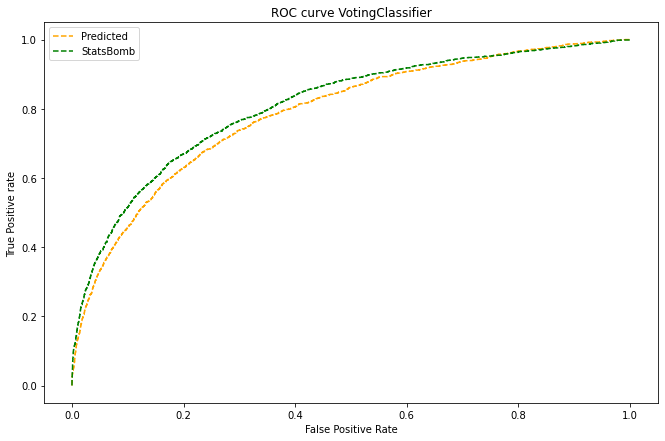

In [11]:
# ROC Curve

fpr_pred, tpr_pred, thresh_pred = roc_curve(np.array(y_test), y_ensemble)
fpr_stats, tpr_stats, thresh_stats = roc_curve(np.array(y_test), np.array(test.statsbomb_xg))

plt.figure(figsize= (11,7))

plt.plot(fpr_pred, tpr_pred, linestyle='--',color='orange', label='Predicted')
plt.plot(fpr_stats, tpr_stats, linestyle='--',color='green', label='StatsBomb')
# title
plt.title('ROC curve ' + name)
# x label
plt.xlabel('False Positive Rate')
# y label
plt.ylabel('True Positive rate')

plt.legend(loc='best')
plt.show()

In [12]:
test['predicted_xG'] = y_ensemble

title = "Predicted xG vs Statsbomb spread"

fig = px.scatter(
    data_frame= test,
    x= 'predicted_xG',
    y= 'statsbomb_xg',
    color= 'predicted_xG',
    title= title,
    template= 'simple_white',
    labels={'x': 'y_pred', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl'
)

fig.show()

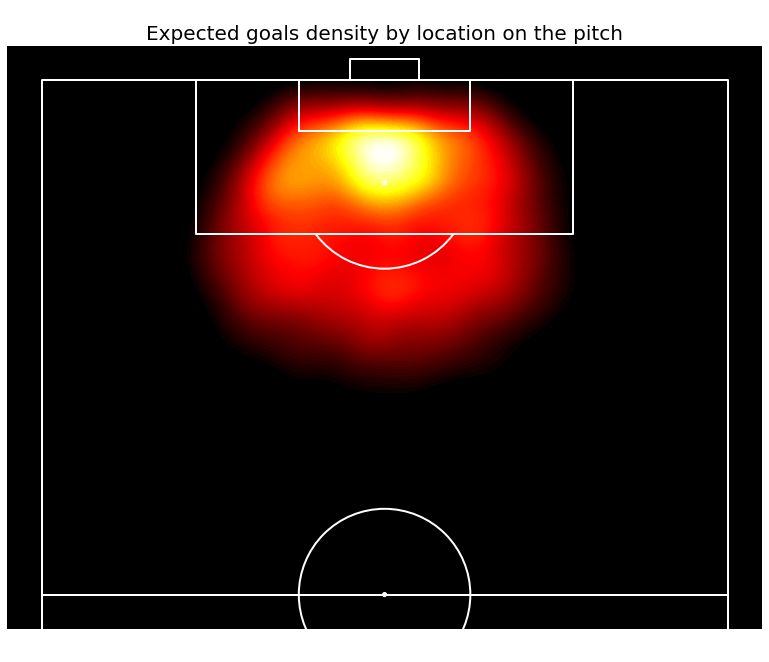

In [13]:
# Density plot based on location on the pitch

pitch = VerticalPitch(
    pitch_type= 'statsbomb',
    pitch_color='black',
    line_color='white',
    goal_type= 'box',
    line_zorder= 5,
    half = True, 
)


fig, ax = pitch.grid(
    grid_height=0.9, 
    title_height=0.06, 
    axis=False, 
    endnote_height=0.04, 
    title_space=0, 
    endnote_space=0,
)

ax['pitch'].set_title("Expected goals density by location on the pitch", fontsize = 20)


kde = pitch.kdeplot(
    test.location_x,
    test.location_y,
    ax=ax['pitch'], 
    cmap='hot', 
    fill=True, 
    levels=100
)

In [14]:
title = "Predicted xG w.r.t. shot distances"

fig = px.scatter(
    data_frame= test,
    x= 'predicted_xG',
    y= 'distances',
    color= 'predicted_xG',
    title= title,
    template= 'simple_white',
    labels={'x': 'predicted xG', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl',
    trendline= 'lowess',
)

fig.show()

In [15]:
title = "StatsBomb xG w.r.t. shot distances"

fig = px.scatter(
    data_frame= test,
    x= 'statsbomb_xg',
    y= 'distances',
    color= 'statsbomb_xg',
    title= title,
    template= 'simple_white',
    labels={'x': 'y_pred', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl',
    trendline= 'lowess'
)

fig.show()

In [16]:
title = "Predicted xG w.r.t. shot angles"

fig = px.scatter(
    data_frame= test,
    x= 'predicted_xG',
    y= 'angles',
    color= 'predicted_xG',
    title= title,
    template= 'simple_white',
    labels={'x': 'y_pred', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl',
    trendline= 'lowess'
)

fig.show()

In [17]:
title = "StatsBomb xG w.r.t. shot angles"

fig = px.scatter(
    data_frame= test,
    x= 'statsbomb_xg',
    y= 'angles',
    color= 'statsbomb_xg',
    title= title,
    template= 'simple_white',
    labels={'x': 'y_pred', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl',
    trendline= 'lowess'
)

fig.show()

# Test Cases

## Test case 1: SIngle match results
### Real Madrid vs Juventus: UEFA Champions League Final 2017

- Match ID is 18244

In [18]:
# Filtering the single match data

test_case = shots[shots.match_id == 18244]

test_case = test_case[['shot_id', 'match_id', 'competition_id', 
                       'season_id', 'statsbomb_xg', 'location_x', 'location_y', 
                       'possession_team', 'period', 'minute', 'second', 'aerial_won',
                       'first_time', 'one_on_one', 'redirect', 'technique_id',
                       'body_part_id', 'type_id', 'player_id', 
                       'total_players', 'opponent', 'angles', 'distances', 'goal']]

team = test_case.possession_team.unique()
team

array(['Juventus', 'Real Madrid'], dtype=object)

In [19]:
fil = test_case.possession_team == team[1]
test_team_1 = test_case[~fil]
test_team_2 = test_case[fil]

X_team_1 = test_team_1.iloc[:, 8:-1]
y_team_1 = test_team_1.iloc[:, -1]

X_team_2 = test_team_2.iloc[:, 8:-1]
y_team_2 = test_team_2.iloc[:, -1]

y_ensemble_team_1 = soft_voting.predict_proba(X_team_1)[:, 1]
y_ensemble_team_2 = soft_voting.predict_proba(X_team_2)[:, 1]


name = soft_voting.__class__.__name__

# Calculation for team 1

statsbomb_xG_team_1 = float(round(sum(test_team_1.statsbomb_xg), 1))
actual_xG_team_1 = np.sum(y_team_1 == 1)
predicted_xG_team_1 = float(round(sum(y_ensemble_team_1), 1))

# Calculation for team 2

statsbomb_xG_team_2 = float(round(sum(test_team_2.statsbomb_xg), 1))
actual_xG_team_2 = np.sum(y_team_2 == 1)
predicted_xG_team_2 = float(round(sum(y_ensemble_team_2), 1))

print(name)
print('\n{} v {} UCL final 2017\n'.format(team[0], team[1]))


print('{} statsbomb_xG: '.format(team[0]), statsbomb_xG_team_1, '  {} statsbomb_xG: '.format(team[1]), statsbomb_xG_team_2, '\n')
print('{} predicted_xG: '.format(team[0]), predicted_xG_team_1, '  {} predicted_xG: '.format(team[1]), predicted_xG_team_2, '\n')
print('{} actual_goals: '.format(team[0]), actual_xG_team_1, '    {} actual_goals: '.format(team[1]), actual_xG_team_2)

VotingClassifier

Juventus v Real Madrid UCL final 2017

Juventus statsbomb_xG:  0.4   Real Madrid statsbomb_xG:  1.6 

Juventus predicted_xG:  0.5   Real Madrid predicted_xG:  1.9 

Juventus actual_goals:  1     Real Madrid actual_goals:  4


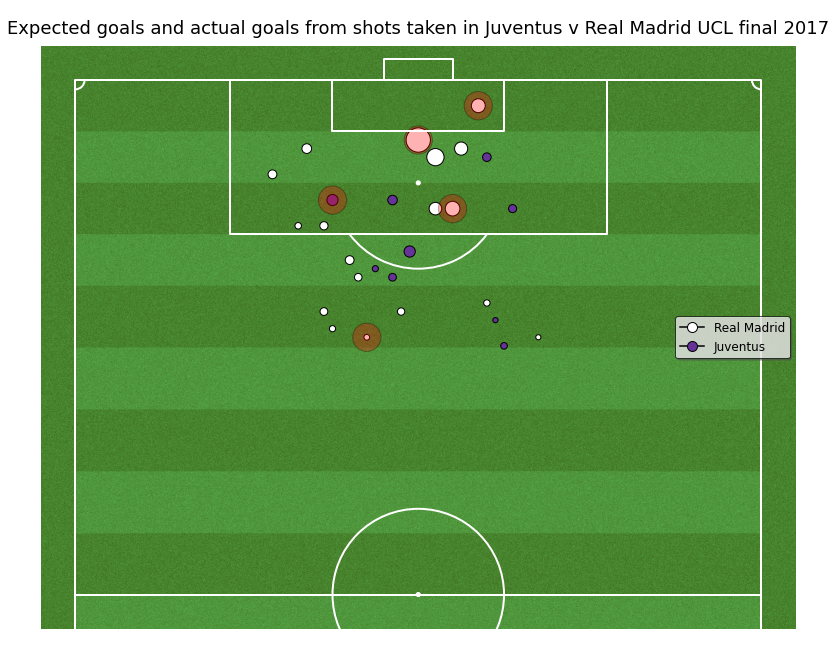

In [20]:
# Pitch map for shots and their xG

pitch = VerticalPitch(
    pitch_type= 'statsbomb',
    pitch_color= PITCH_COLOR, 
    line_color='white', 
    half = True, 
    goal_type= 'box',
    corner_arcs= True,
    stripe=True,
    line_zorder=3
)

fig, ax = pitch.grid(
    grid_height=0.9, 
    title_height=0.06, 
    axis=False, 
    endnote_height=0.04, 
    title_space=0, 
    endnote_space=0,
)

#plotting all shots
team_1 = pitch.scatter(
    test_team_1.location_x, 
    test_team_1.location_y, 
    alpha = 1, 
    s = y_ensemble_team_1 * 1200, 
    color = 'rebeccapurple', 
    ax=ax['pitch'], 
    edgecolors="black"
) 

goals_1 = pitch.scatter(
    test_team_1.location_x, 
    test_team_1.location_y, 
    alpha = .3, 
    s = test_team_1.goal * 800, 
    color = 'red', 
    ax=ax['pitch'], 
    edgecolors="black"
) 

team_2 = pitch.scatter(
    test_team_2.location_x, 
    test_team_2.location_y, 
    alpha = 1, 
    s = y_ensemble_team_2 * 1200, 
    color = 'white', 
    ax=ax['pitch'], 
    edgecolors="black"
) 

goals_2 = pitch.scatter(
    test_team_2.location_x, 
    test_team_2.location_y, 
    alpha = .3, 
    s = test_team_2.goal * 800, 
    color = 'red', 
    ax=ax['pitch'], 
    edgecolors="black"
) 


legend_elements = [
    Line2D([0], [0], marker='o', color='k', markerfacecolor='white', markersize=10, label=team[1]),
    Line2D([0], [0], marker='o', color='k', markerfacecolor='rebeccapurple', markersize=10, label=team[0])
]

# Add the custom legend
ax['pitch'].legend(
    handles=legend_elements, 
    loc= 7,
    framealpha=0.7,
    facecolor= 'white',
    fontsize= 12, 
    edgecolor= 'black', 
    shadow = True
)
# ax['pitch'].legend()


fig.suptitle("Expected goals and actual goals from shots taken in Juventus v Real Madrid UCL final 2017", fontsize = 18)           
plt.show()

## Test Case 2:
### Goals by an individual player

### Separating data for test case (Shots by player)

In [21]:
# PLAYERWISE
## Overperforming player
player = shots[(shots.competition_id == 43) & (shots.season_id == 106) & (shots.player_name == 'Kylian Mbappé Lottin')]


## Underperforming player
# player = shots[(shots.competition_id == 43) & (shots.season_id == 3) & (shots.player_name == 'Neymar da Silva Santos Junior')]

In [22]:
shots_player = player[['shot_id', 'match_id', 'competition_id', 
                       'season_id', 'possession_team', 'location_x', 'location_y',
                       'statsbomb_xg', 'period', 'minute', 'second', 'aerial_won',
                       'first_time', 'one_on_one', 'redirect', 'technique_id',
                       'body_part_id', 'type_id', 'player_id', 'total_players', 
                       'opponent', 'angles', 'distances', 'goal']]

X_shots_player = shots_player.iloc[:, 8:-1]
y_shots_player = shots_player.iloc[:, -1]

y_ensemble = soft_voting.predict_proba(X_shots_player)[:, 1]

name = soft_voting.__class__.__name__
corr = pearsonr(np.array(shots_player.statsbomb_xg), y_ensemble)
auc_pred = roc_auc_score(np.array(y_shots_player), y_ensemble)
auc_stats = roc_auc_score(np.array(y_shots_player), np.array(shots_player.statsbomb_xg))

statsbomb_xG = float(round(sum(shots_player.statsbomb_xg), 1))
actual_xG = np.sum(y_shots_player == 1)
predicted_xG = float(round(sum(y_ensemble), 1))

print(name)

if player.season_id.unique()[0] == 3:
    print('Shots by {} in World Cup 2018 (No penalties)\n'.format(player.player_name.unique()[0]))
elif player.season_id.unique()[0] == 106:
    print('Shots by {} in World Cup 2022 (No penalties)\n'.format(player.player_name.unique()[0]))
else: 
    None

print('Correlation coefficient: %.3f' %corr[0])
print('AUC of ensemble learning: %.3f' %auc_pred)
print('AUC of statsbom_xG: %.3f' %auc_stats)
print('statsbomb_xG: ', statsbomb_xG)
print('predicted_xG: ', predicted_xG)
print('actual_goals: ', actual_xG)

VotingClassifier
Shots by Kylian Mbappé Lottin in World Cup 2022 (No penalties)

Correlation coefficient: 0.758
AUC of ensemble learning: 0.862
AUC of statsbom_xG: 0.775
statsbomb_xG:  2.7
predicted_xG:  4.0
actual_goals:  6


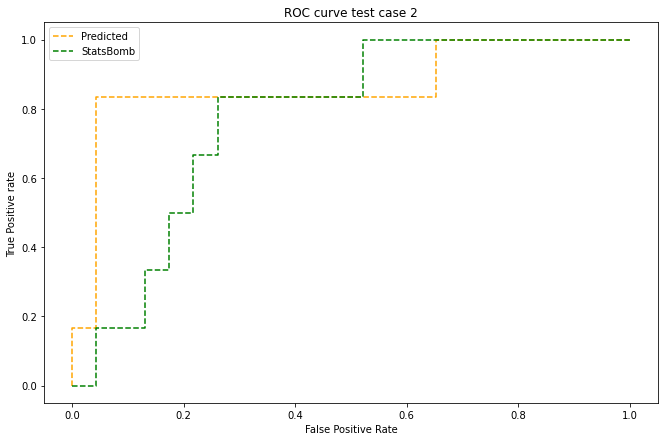

In [23]:
# ROC Curve for test case 2

fpr_pred, tpr_pred, thresh_pred = roc_curve(np.array(y_shots_player), y_ensemble)
fpr_stats, tpr_stats, thresh_stats = roc_curve(np.array(y_shots_player), np.array(shots_player.statsbomb_xg))

plt.figure(figsize= (11,7))

plt.plot(fpr_pred, tpr_pred, linestyle='--',color='orange', label='Predicted')
plt.plot(fpr_stats, tpr_stats, linestyle='--',color='green', label='StatsBomb')
# title
plt.title('ROC curve test case 2')
# x label
plt.xlabel('False Positive Rate')
# y label
plt.ylabel('True Positive rate')

plt.legend(loc='best')
plt.show()

In [24]:
shots_player['predicted_xG'] = y_ensemble

In [25]:
title = "Expected goal from shots taken by {} in World Cup by minute".format(player.player_name.unique()[0])

fig = px.histogram(data_frame= shots_player, 
                   x= 'minute',
                   y= y_ensemble,
                   title= title,
                   template= 'simple_white',
                   labels={'x': 'Minutes', 'y': 'predicted xG'},
                   width= 900,
                   height= 550
                  )

fig.show()

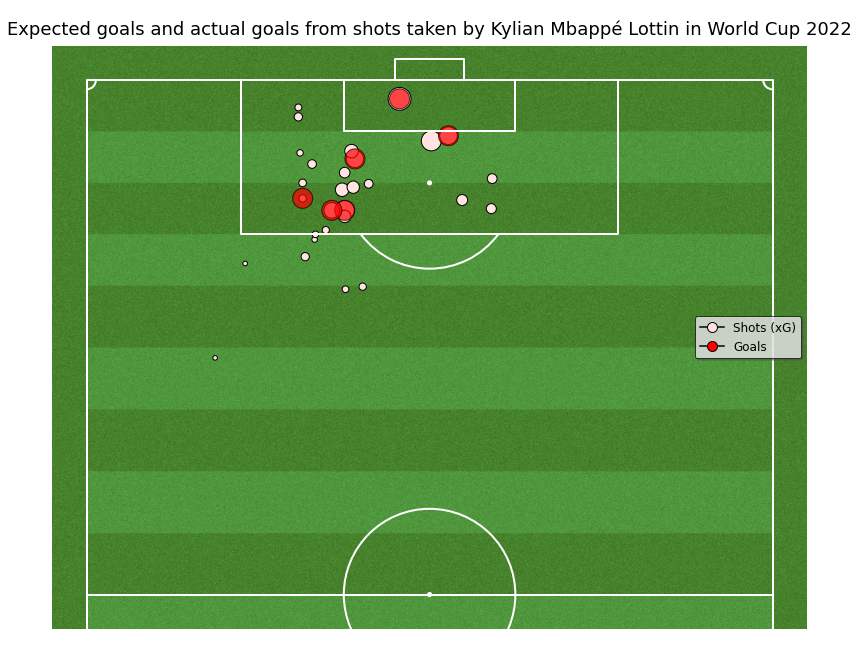

In [26]:
# Pitch map for shots and their xG

pitch = VerticalPitch(
    pitch_type= 'statsbomb',
    pitch_color= PITCH_COLOR, 
    half = True, 
    goal_type= 'box',
    corner_arcs= True,
    line_color='white',
    stripe=True,
    line_zorder=3
)

fig, ax = pitch.grid(     
    grid_height=0.9,      
    title_height=0.06,      
    axis=False,      
    endnote_height=0.04,      
    title_space=0,      
    endnote_space=0, 
)

#plotting all shots
shot_xG = pitch.scatter(
    shots_player.location_x, 
    shots_player.location_y, 
    alpha = 1, 
    s = y_ensemble * 1000, 
    color = 'mistyrose', 
    ax=ax['pitch'], 
    edgecolors="black"
) 

goals = pitch.scatter(
    shots_player.location_x, 
    shots_player.location_y, 
    alpha = .7, 
    s = shots_player.goal * 400, 
    color = 'red', 
    ax=ax['pitch'], 
    edgecolors="black"
) 

# Add the custom legend
legend_elements = [
    Line2D([0], [0], marker='o', color='k', markerfacecolor='mistyrose', markersize=10, label='Shots (xG)'),
    Line2D([0], [0], marker='o', color='k', markerfacecolor='red', markersize=10, label='Goals')
]

ax['pitch'].legend(
    handles=legend_elements, 
    loc= 7, 
    framealpha=0.7,
    facecolor= 'white',
    fontsize= 12, 
    edgecolor= 'black', 
    shadow = True
)

fig.suptitle("Expected goals and actual goals from shots taken by {} in World Cup 2022".format(player.player_name.unique()[0]), fontsize = 18)           
plt.show()

In [27]:
title = "Predicted xG w.r.t. shot distances"

fig = px.scatter(
    data_frame= shots_player,
    x= 'predicted_xG',
    y= 'distances',
    color= 'predicted_xG',
    title= title,
    template= 'simple_white',
    labels={'x': 'y_pred', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl',
    trendline= 'lowess',
)

fig.show()

In [28]:
title = "StatsBomb xG w.r.t. shot distances"

fig = px.scatter(
    data_frame= shots_player,
    x= 'statsbomb_xg',
    y= 'distances',
    color= 'statsbomb_xg',
    title= title,
    template= 'simple_white',
    labels={'x': 'y_pred', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl',
    trendline= 'lowess',
)

fig.show()

In [29]:
title = "Predicted xG w.r.t. shot angles"

fig = px.scatter(
    data_frame= shots_player,
    x= 'predicted_xG',
    y= 'angles',
    color= 'predicted_xG',
    title= title,
    template= 'simple_white',
    labels={'x': 'y_pred', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl',
    trendline= 'lowess',
)

fig.show()

In [30]:
title = "StatsBomb xG w.r.t. shot angles"

fig = px.scatter(
    data_frame= shots_player,
    x= 'statsbomb_xg',
    y= 'angles',
    color= 'statsbomb_xg',
    title= title,
    template= 'simple_white',
    labels={'x': 'y_pred', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl',
    trendline= 'lowess',
)

fig.show()

# Test case 3:

## Shots by a particular team

In [31]:
# TEAMWISE
## Overperforming team
# team = shots[(shots.competition_id == 43) & (shots.season_id == 106) & (shots.possession_team == 'France')]
team = shots[(shots.competition_id == 43) & (shots.season_id == 3) & (shots.possession_team == 'France')]
# team = shots[(shots.competition_id == 43) & (shots.season_id == 3) & (shots.possession_team == 'Croatia')]
# team = shots[(shots.competition_id == 43) & (shots.season_id == 3) & (shots.possession_team == 'Belgium')]


## Under performing team
# team = shots[(shots.competition_id == 43) & (shots.season_id == 3) & (shots.possession_team == 'Germany')]
# team = shots[(shots.competition_id == 43) & (shots.season_id == 3) & (shots.possession_team == 'Brazil')]

In [32]:
shots_team = team[['shot_id', 'match_id', 'competition_id', 
                   'season_id', 'possession_team', 'location_x', 'location_y',
                   'statsbomb_xg', 'period', 'minute', 'second', 'aerial_won',
                   'first_time', 'one_on_one', 'redirect', 'technique_id',
                   'body_part_id', 'type_id', 'player_id', 'total_players', 
                   'opponent', 'angles', 'distances', 'goal']]

X_shots_team = shots_team.iloc[:, 8:-1]
y_shots_team = shots_team.iloc[:, -1]

y_ensemble = soft_voting.predict_proba(X_shots_team)[:, 1]

name = soft_voting.__class__.__name__
corr = pearsonr(np.array(shots_team.statsbomb_xg), y_ensemble)
auc_pred = roc_auc_score(np.array(y_shots_team), y_ensemble)
auc_stats = roc_auc_score(np.array(y_shots_team), np.array(shots_team.statsbomb_xg))

statsbomb_xG = float(round(sum(shots_team.statsbomb_xg), 1))
actual_xG = np.sum(y_shots_team == 1)
predicted_xG = float(round(sum(y_ensemble), 1))


print(name)

if team.season_id.unique()[0] == 3:
    print('Shots by {} in World Cup 2018 (No penalties)\n'.format(team.possession_team.unique()[0]))
elif team.season_id.unique()[0] == 106:
    print('Shots by {} in World Cup 2022 (No penalties)\n'.format(team.possession_team.unique()[0]))
    
print('\nCorrelation coefficient: %.3f' %corr[0])
print('AUC of ensemble learning: %.3f' %auc_pred)
print('AUC of statsbom_xG: %.3f' %auc_stats)
print('statsbomb_xG: ', statsbomb_xG)
print('predicted_xG: ', predicted_xG)
print('actual_goals: ', actual_xG)

VotingClassifier
Shots by France in World Cup 2018 (No penalties)


Correlation coefficient: 0.847
AUC of ensemble learning: 0.732
AUC of statsbom_xG: 0.659
statsbomb_xG:  6.5
predicted_xG:  8.0
actual_goals:  9


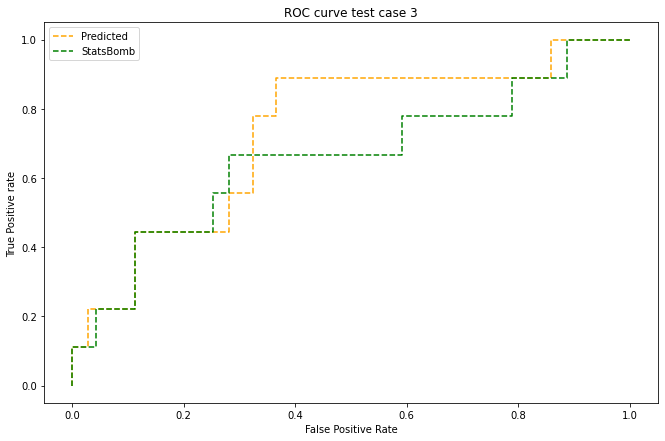

In [33]:
# ROC Curve for test case 3

fpr_pred, tpr_pred, thresh_pred = roc_curve(np.array(y_shots_team), y_ensemble)
fpr_stats, tpr_stats, thresh_stats = roc_curve(np.array(y_shots_team), np.array(shots_team.statsbomb_xg))

plt.figure(figsize= (11,7))
plt.plot(fpr_pred, tpr_pred, linestyle='--',color='orange', label='Predicted')
plt.plot(fpr_stats, tpr_stats, linestyle='--',color='green', label='StatsBomb')
# title
plt.title('ROC curve test case 3')
# x label
plt.xlabel('False Positive Rate')
# y label
plt.ylabel('True Positive rate')

plt.legend(loc='best')
plt.show()

In [34]:
shots_team['predicted_xG'] = y_ensemble

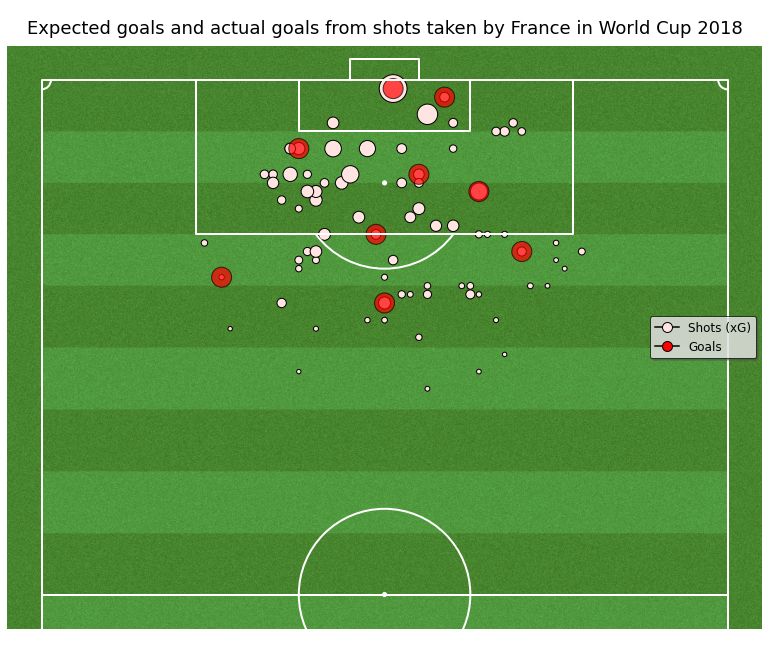

In [35]:
# Pitch map for shots and their xG


pitch = VerticalPitch(
    pitch_type= 'statsbomb',
    pitch_color= PITCH_COLOR,
    half = True, 
    goal_type= 'box',
    line_color='white',
    stripe=True,
    corner_arcs= True,
    line_zorder=3
)

fig, ax = pitch.grid(     
    grid_height=0.9,      
    title_height=0.06,      
    axis=False,      
    endnote_height=0.04,      
    title_space=0,      
    endnote_space=0, 
)


#plotting all shots
shot_xG = pitch.scatter(
    shots_team.location_x, 
    shots_team.location_y, 
    alpha = 1, 
    s = y_ensemble * 1000, 
    color = 'mistyrose', 
    ax=ax['pitch'], 
    edgecolors="black"
) 

goals = pitch.scatter(
    shots_team.location_x, 
    shots_team.location_y, 
    alpha = .7, 
    s = shots_team.goal * 400, 
    color = 'red', 
    ax=ax['pitch'], 
    edgecolors="black"
) 


legend_elements = [
    Line2D([0], [0], marker='o', color='k', markerfacecolor='mistyrose', markersize=10, label='Shots (xG)'),
    Line2D([0], [0], marker='o', color='k', markerfacecolor='red', markersize=10, label='Goals')
]

# Add the custom legend
ax['pitch'].legend(
    handles=legend_elements, 
    loc= 0, 
    facecolor= 'white',     
    framealpha=0.7,
    fontsize= 12, 
    edgecolor= 'black', 
    shadow = True
)

if team.season_id.unique()[0] == 3:
    fig.suptitle("Expected goals and actual goals from shots taken by {} in World Cup 2018".format(shots_team.possession_team.unique()[0]), fontsize = 18)           
    
elif team.season_id.unique()[0] == 106:
    fig.suptitle("Expected goals and actual goals from shots taken by {} in World Cup 2022".format(shots_team.possession_team.unique()[0]), fontsize = 18)           

plt.show()


In [36]:
title = "Predicted xG w.r.t. shot distances"

fig = px.scatter(
    data_frame= shots_team,
    x= 'predicted_xG',
    y= 'distances',
    color= 'predicted_xG',
    title= title,
    template= 'simple_white',
    labels={'x': 'y_pred', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl',
    trendline= 'lowess',
)

fig.show()

In [37]:
title = "StatsBomb xG w.r.t. shot distances"

fig = px.scatter(
    data_frame= shots_team,
    x= 'statsbomb_xg',
    y= 'distances',
    color= 'statsbomb_xg',
    title= title,
    template= 'simple_white',
    labels={'x': 'y_pred', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl',
    trendline= 'lowess',
)

fig.show()

In [38]:
title = "Predicted xG w.r.t. shot angles"

fig = px.scatter(
    data_frame= shots_team,
    x= 'predicted_xG',
    y= 'angles',
    color= 'predicted_xG',
    title= title,
    template= 'simple_white',
    labels={'x': 'y_pred', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl',
    trendline= 'lowess',
)

fig.show()

In [39]:
title = "StatsBomb xG w.r.t. shot angles"

fig = px.scatter(
    data_frame= shots_team,
    x= 'statsbomb_xg',
    y= 'angles',
    color= 'statsbomb_xg',
    title= title,
    template= 'simple_white',
    labels={'x': 'y_pred', 'y': 'statsbomb_xg'},
    width= 700,
    height= 550,
    color_continuous_scale='bluyl',
    trendline= 'lowess',
)

fig.show()

In [40]:
if team.season_id.unique()[0] == 3:
    title = "Expected goal from shots taken by {} in World Cup 2018 by minute".format(team.possession_team.unique()[0])
    
elif team.season_id.unique()[0] == 106:
    title = "Expected goal from shots taken by {} in World Cup 2022 by minute".format(team.possession_team.unique()[0])
    
fig = px.histogram(data_frame= shots_team, 
                   x= 'minute',
                   y= y_ensemble,
                   title= title,
                   template= 'simple_white',
                   labels={'x': 'Minutes', 'y': 'predicted xG'},
                   width= 700,
                   height= 550,
                  )

fig.show()

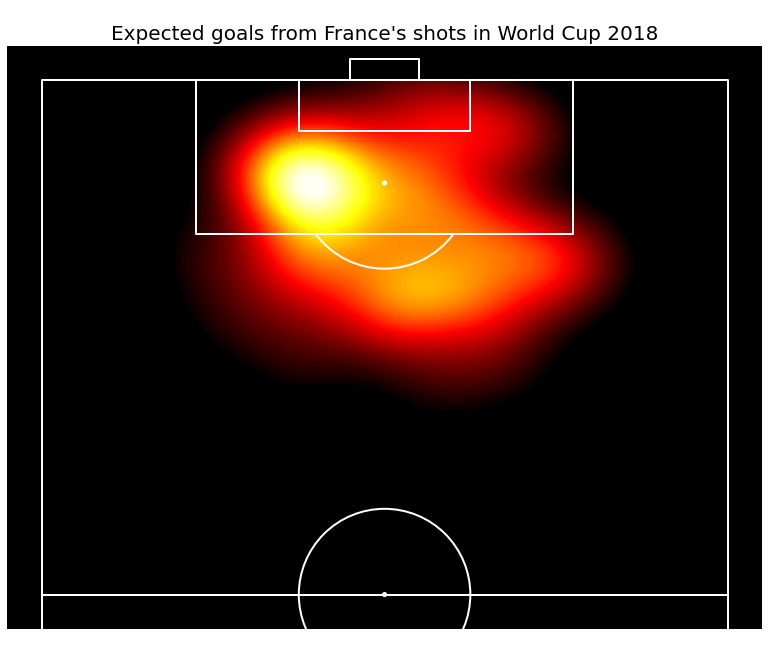

In [41]:
pitch = VerticalPitch(
    pitch_type= 'statsbomb',
    pitch_color='black',
    goal_type= 'box',
    line_color='white',
    line_zorder= 5,
    half = True, 
)


fig, ax = pitch.grid(     
    grid_height=0.9,      
    title_height=0.06,      
    axis=False,      
    endnote_height=0.04,      
    title_space=0,      
    endnote_space=0, 
)


if team.season_id.unique()[0] == 3:
    ax['pitch'].set_title("Expected goals from {}'s shots in World Cup 2018".format(shots_team.possession_team.unique()[0]), fontsize = 20)
    
elif team.season_id.unique()[0] == 106:
    ax['pitch'].set_title("Expected goals from {}'s shots in World Cup 2022".format(shots_team.possession_team.unique()[0]), fontsize = 20)
    

kdeplot_light = pitch.kdeplot(
    shots_team.location_x,
    shots_team.location_y,
    ax=ax['pitch'], 
    cmap='hot', 
    fill=True, 
    levels=100
)